<a href="https://colab.research.google.com/github/penguinhouse/AIFFEL_quest_iNho/blob/main/Exploration_quest/Quest01/01_EX_xception_tf_flowers_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 01_Exploration. 프로젝트: 새로운 데이터셋으로 나만의 이미지 분류기 만들어보기

| 평가문항  | 상세기준 |
| :--- | :--- |
| 1. base 모델을 활용한 Transfer learning이 성공적으로 진행되었는가? | VGG16 등이 적절히 활용되었음 |
| 2. 학습과정 및 결과에 대한 설명이 시각화를 포함하여 체계적으로 진행되었는가?| loss, accuracy 그래프 및 임의 사진 추론 결과가 제시됨 |   
| 3. 분류모델의 test accuracy가 기준 이상 높게 나왔는가? | test accuracy가 85% 이상 도달하였음 |


## 소감

---
tensorflow_datasets의 tf_flowers 데이터셋을 기반으로 Accuracy 성능이
뛰어나다고 알려진 Exception (Extreme inception) 모듈로 모델을 디자인하였습니다. 데이터 전처리 과정에서 Autotune 기법을 적용했고, 모델의 성능 최적화 과정에서set_seed() 함수를 사용하여 재현성을 보장하려는 시도를 하였습니다.

학습 결과는  
Test accuracy: 0.945
Test loss: 0.134

이미지 테스트 90.625

VGG17의 87.5 보다는 월등히 높게 나왔지만
데이터셋 이외의 이미지로 무작위 테스트 한 결과는 너무도 실망스러웠습니다.
그 원인을 찾고자 노력하였으나 무위로 프로젝트를 마감할 수 밖에 없었습니다.

프로젝트 과정에서 제반 이미지 분류 모델을 전체적으로 살필 수 있어 좋았고 그 중에서 프랑수아 숄레의 모델, Xception 의 depthwise separable convolution layer에 대한 이해를 조금이나마 할 수 있어 기뻤습니다.


## 라이브러리

In [45]:
# 필요한 라이브러리 불러오기
import numpy as np
import os
import PIL
import PIL.Image
import tensorflow as tf
from tensorflow import keras


import matplotlib.pyplot as plt

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential



from tensorflow.keras import applications,layers,models,optimizers

from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt

import tensorflow_datasets as tfds

dataset, info = tfds.load("tf_flowers", as_supervised=True, with_info=True)
dataset_size = info.splits["train"].num_examples
class_names = info.features["label"].names
n_classes = info.features["label"].num_classes

print("TensorFlow version:", tf.__version__)
print("Datasets version:", tfds.__version__)

TensorFlow version: 2.14.0
Datasets version: 4.9.3


## 데이터셋

In [46]:
# test_set_raw, valid_set_raw, train_set_raw = tfds.load(
#     "tf_flowers",
#     split=["train[:10%]", "train[10%:25%]", "train[25%:]"], # 데이터셋의 처음 10% tetest_set_rawst_set, 다음 15% valid_set_raw, 나머지 75% train_set_raw
#     as_supervised=True)

#### 다른 접근
# import pathlib
# dataset_url = "https://www.tensorflow.org/tutorials/load_data/images"
# data_dir = tf.keras.utils.get_file('tf_flowers', origin=dataset_url, untar=True)
# data_dir = pathlib.Path(data_dir)

(train_set_raw, valid_set_raw, test_set_raw), metadata = tfds.load( # tfds.load/
    name='tf_flowers',
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'], # 데이터셋의 처음 10% tetest_set_rawst_set, 다음 15% valid_set_raw, 나머지 75% train_set_raw
    data_dir='/tf_flowers/',
    download=True,
    with_info=True,
    as_supervised=True,
)

print("Train data:", train_set_raw)
print("Validation data:", valid_set_raw)
print("Test data", test_set_raw)

Train data: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
Validation data: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
Test data <_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


In [47]:
train_image_count = len(list(train_set_raw))
valication_image_count = len(list(valid_set_raw))
test_image_count = len(list(test_set_raw))
num_classes = metadata.features['label'].num_classes

print("Train image:", train_image_count)
print("Validation image:", valication_image_count)
print("Test image:", test_image_count)
print("Number of classes:", num_classes)

Train image: 2936
Validation image: 367
Test image: 367
Number of classes: 5


In [124]:
class_labels = metadata.features['label'].names[:5]

print("어떤 라벨들이 있나?:")
for i, label in enumerate(class_labels):
    print(f"{i + 1}: {label}")

어떤 라벨들이 있나?:
1: dandelion
2: daisy
3: tulips
4: sunflowers
5: roses


In [49]:
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

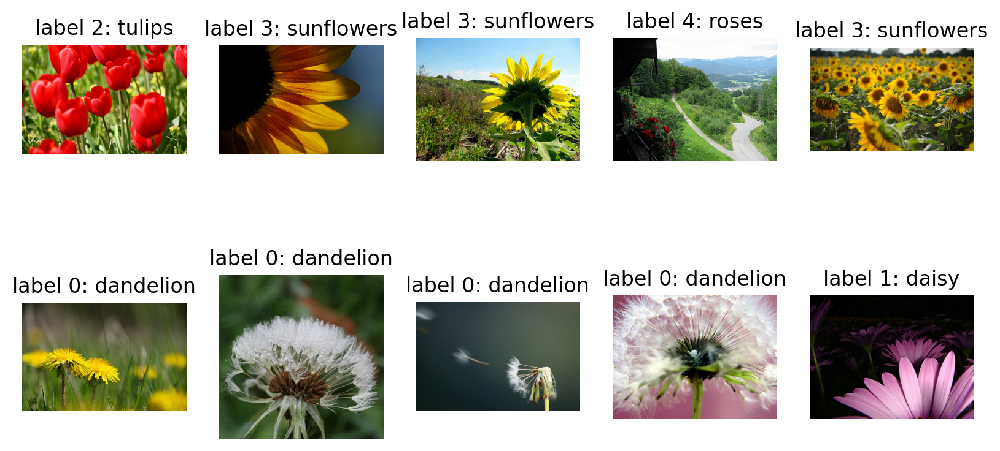

In [50]:
plt.figure(figsize=(10, 5))

get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(train_set_raw.take(10)):
    plt.subplot(2, 5, idx+1)
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

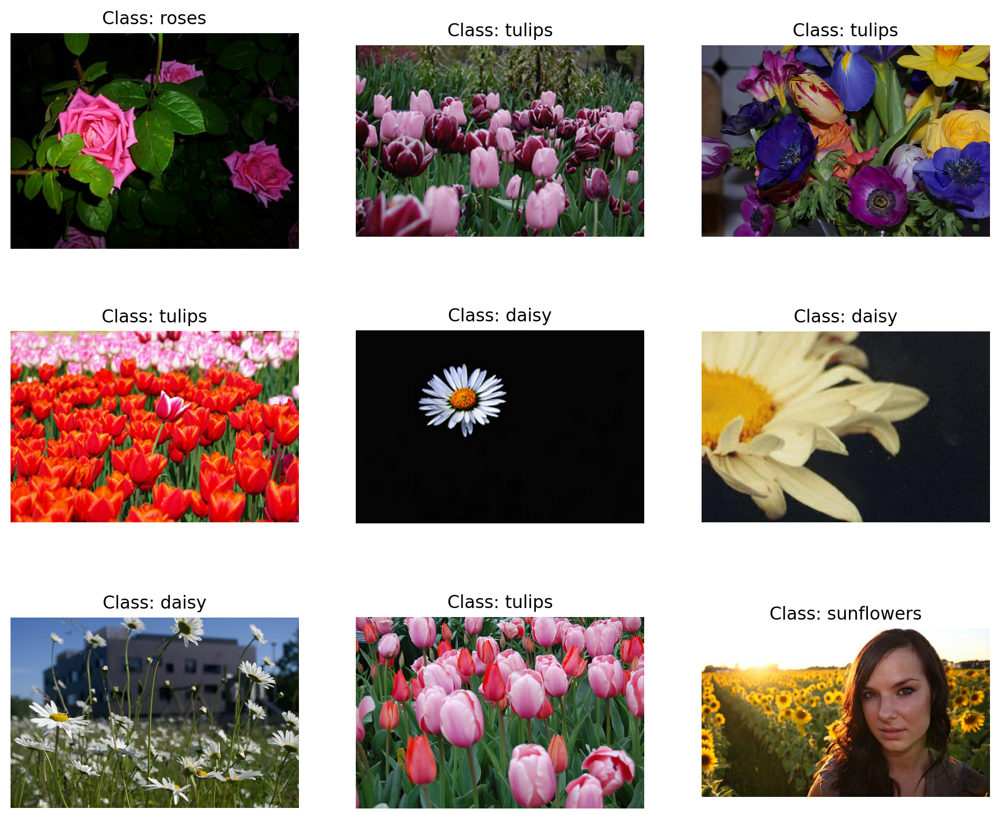

In [51]:
# evalidation set에서 첫 9 이미지 표시

plt.figure(figsize=(12, 10))
index = 0
for image, label in valid_set_raw.take(9):
    index += 1
    plt.subplot(3, 3, index)
    plt.imshow(image)
    plt.title(f"Class: {class_names[label]}")
    plt.axis("off")

plt.show()

In [52]:
tf.keras.backend.clear_session()  # 레이어 이름 카운터 재설정

batch_size = 32
preprocess = tf.keras.Sequential([
    tf.keras.layers.Resizing(height=224, width=224, crop_to_aspect_ratio=True),
    tf.keras.layers.Lambda(tf.keras.applications.xception.preprocess_input)
])
train_set = train_set_raw.map(lambda X, y: (preprocess(X), y))
train_set = train_set.shuffle(1000, seed=44).batch(batch_size).prefetch(1)
valid_set = valid_set_raw.map(lambda X, y: (preprocess(X), y)).batch(batch_size)
test_set = test_set_raw.map(lambda X, y: (preprocess(X), y)).batch(batch_size)

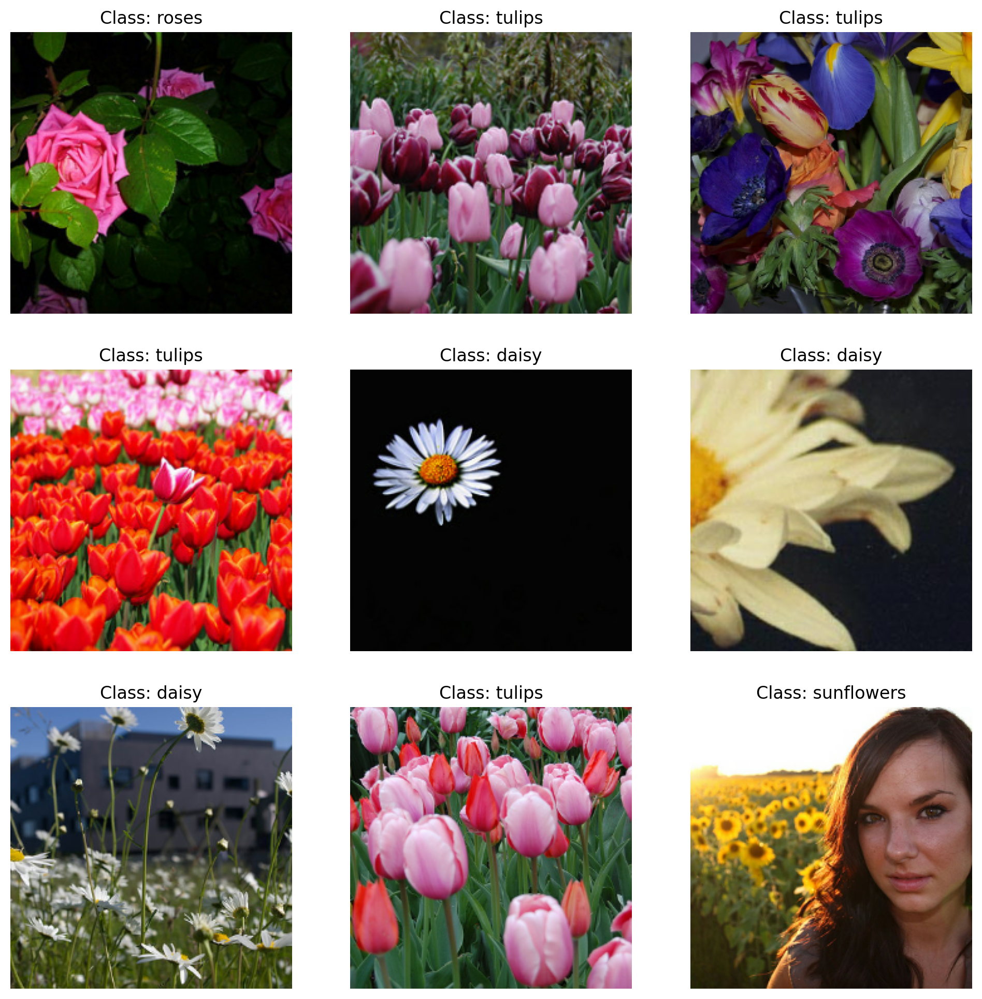

In [53]:
# valid_set 배치 첫 9개 이미지 표시

plt.figure(figsize=(12, 12))
for X_batch, y_batch in valid_set.take(1):
    for index in range(9):
        plt.subplot(3, 3, index + 1)
        plt.imshow((X_batch[index] + 1) / 2)  # rescale to 0–1 for imshow()
        plt.title(f"Class: {class_names[y_batch[index]]}")
        plt.axis("off")

plt.show()

In [54]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip(mode="horizontal", seed=44),
    tf.keras.layers.RandomRotation(factor=0.05, seed=44),
    tf.keras.layers.RandomContrast(factor=0.2, seed=44)
])

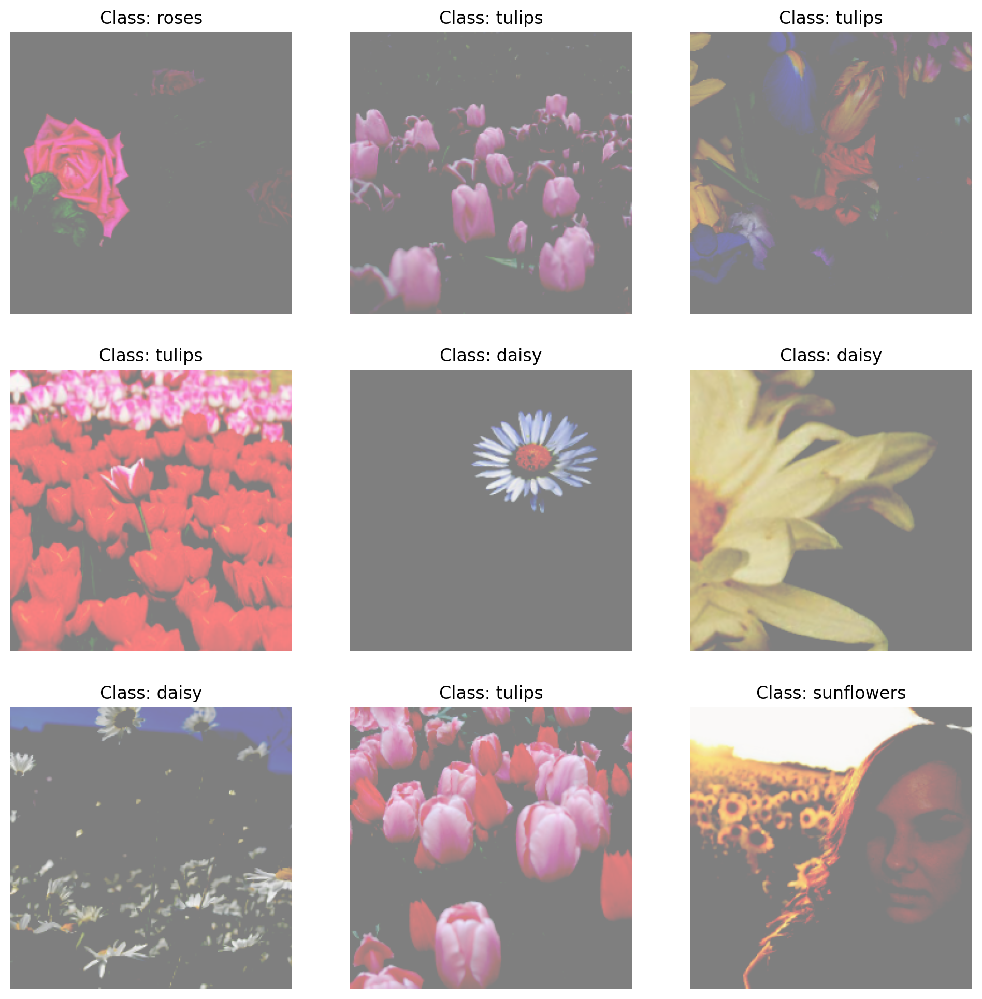

In [55]:
# 증강 후 첫 9개 이미지 표시

plt.figure(figsize=(12, 12))
for X_batch, y_batch in valid_set.take(1):
    X_batch_augmented = data_augmentation(X_batch, training=True)
    for index in range(9):
        plt.subplot(3, 3, index + 1)
        # imshow()를 위해 이미지 크기를 0-1로 재조정
        # 데이터 증강으로 인해 일부 값이 범위 벗어날 수 있으므로 결과를 해당 범위로 클립
        plt.imshow(np.clip((X_batch_augmented[index] + 1) / 2, 0, 1))
        plt.title(f"Class: {class_names[y_batch[index]]}")
        plt.axis("off")

plt.show()

In [56]:
# 이미지 리사이즈 224

IMG_SIZE = 224

def format_example(image, label):
    image = tf.cast(image, tf.float32)
    image = (image/127.5) - 1
    image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
    return image, label

train = train_set_raw.map(format_example)
validation = valid_set_raw.map(format_example)
test = test_set_raw.map(format_example)

print("Train data:", train)
print("Validation data:", validation)
print("Test data:", test)



Train data: <_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
Validation data: <_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
Test data: <_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


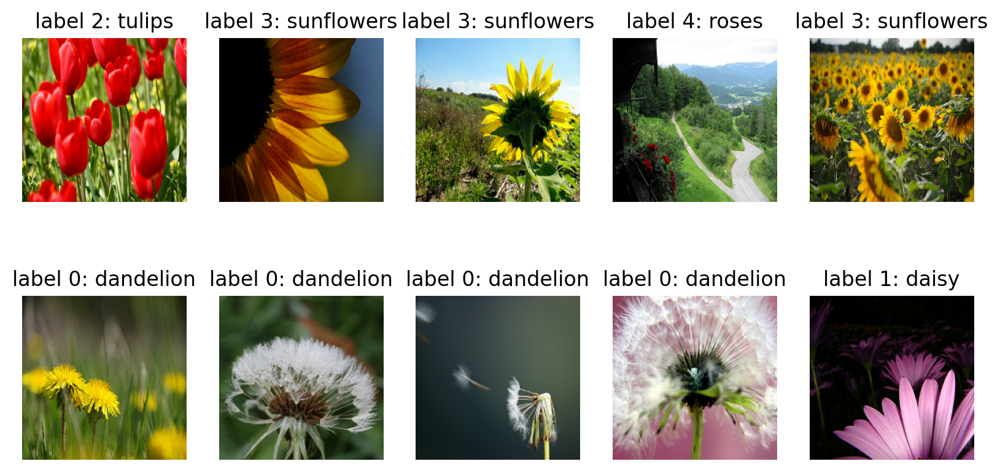

In [57]:
# Checking img-data size

plt.figure(figsize=(10, 5))

get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(train.take(10)):
    plt.subplot(2, 5, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

In [58]:
tf.random.set_seed(44)  # 재현성 보장
base_model = tf.keras.applications.xception.Xception(weights="imagenet",
                                                     include_top=False) # freeze
avg = tf.keras.layers.GlobalAveragePooling2D()(base_model.output)
output = tf.keras.layers.Dense(n_classes, activation="softmax")(avg)
model = tf.keras.Model(inputs=base_model.input, outputs=output)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 block1_conv1 (Conv2D)       (None, None, None, 32)       864       ['input_1[0][0]']             
                                                                                                  
 block1_conv1_bn (BatchNorm  (None, None, None, 32)       128       ['block1_conv1[0][0]']        
 alization)                                                                                       
                                                                                                  
 block1_conv1_act (Activati  (None, None, None, 32)       0         ['block1_conv1_bn[0][0]'] 

In [59]:
for layer in base_model.layers:
    layer.trainable = False # freeze

In [60]:
optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer,
              metrics=["accuracy"])
history = model.fit(train_set, validation_data=valid_set, epochs=3)

Epoch 1/3
92/92 [==============================] - 8s 61ms/step - loss: 0.5506 - accuracy: 0.7953 - val_loss: 0.3440 - val_accuracy: 0.8801
Epoch 2/3
92/92 [==============================] - 5s 53ms/step - loss: 0.3062 - accuracy: 0.8975 - val_loss: 0.2971 - val_accuracy: 0.8937
Epoch 3/3
92/92 [==============================] - 5s 53ms/step - loss: 0.2532 - accuracy: 0.9196 - val_loss: 0.2858 - val_accuracy: 0.9128


In [61]:
for indices in zip(range(33), range(33, 66), range(66, 99), range(99, 132)):
    for idx in indices:
        print(f"{idx:3}: {base_model.layers[idx].name:22}", end="")
    print()

  0: input_1                33: block4_pool            66: block8_sepconv1_act    99: block11_sepconv2_act  
  1: block1_conv1           34: batch_normalization_2  67: block8_sepconv1       100: block11_sepconv2      
  2: block1_conv1_bn        35: add_2                  68: block8_sepconv1_bn    101: block11_sepconv2_bn   
  3: block1_conv1_act       36: block5_sepconv1_act    69: block8_sepconv2_act   102: block11_sepconv3_act  
  4: block1_conv2           37: block5_sepconv1        70: block8_sepconv2       103: block11_sepconv3      
  5: block1_conv2_bn        38: block5_sepconv1_bn     71: block8_sepconv2_bn    104: block11_sepconv3_bn   
  6: block1_conv2_act       39: block5_sepconv2_act    72: block8_sepconv3_act   105: add_9                 
  7: block2_sepconv1        40: block5_sepconv2        73: block8_sepconv3       106: block12_sepconv1_act  
  8: block2_sepconv1_bn     41: block5_sepconv2_bn     74: block8_sepconv3_bn    107: block12_sepconv1      
  9: block2_sepconv

In [62]:
for layer in base_model.layers[56:]:
    layer.trainable = True

optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer,
              metrics=["accuracy"])
history = model.fit(train_set, validation_data=valid_set, epochs=10)

Epoch 1/10
92/92 [==============================] - 17s 102ms/step - loss: 0.3066 - accuracy: 0.8992 - val_loss: 0.2087 - val_accuracy: 0.9237
Epoch 2/10
92/92 [==============================] - 9s 94ms/step - loss: 0.0621 - accuracy: 0.9850 - val_loss: 0.1564 - val_accuracy: 0.9482
Epoch 3/10
92/92 [==============================] - 9s 94ms/step - loss: 0.0214 - accuracy: 0.9976 - val_loss: 0.1538 - val_accuracy: 0.9591
Epoch 4/10
92/92 [==============================] - 9s 94ms/step - loss: 0.0124 - accuracy: 0.9980 - val_loss: 0.1818 - val_accuracy: 0.9537
Epoch 5/10
92/92 [==============================] - 9s 94ms/step - loss: 0.0102 - accuracy: 0.9993 - val_loss: 0.1618 - val_accuracy: 0.9591
Epoch 6/10
92/92 [==============================] - 9s 94ms/step - loss: 0.0092 - accuracy: 0.9980 - val_loss: 0.1646 - val_accuracy: 0.9564
Epoch 7/10
92/92 [==============================] - 9s 94ms/step - loss: 0.0067 - accuracy: 0.9993 - val_loss: 0.1698 - val_accuracy: 0.9537
Epoch 8/10


## 모델 성능 평가

12/12 [==============================] - 1s 41ms/step - loss: 0.1715 - accuracy: 0.9619


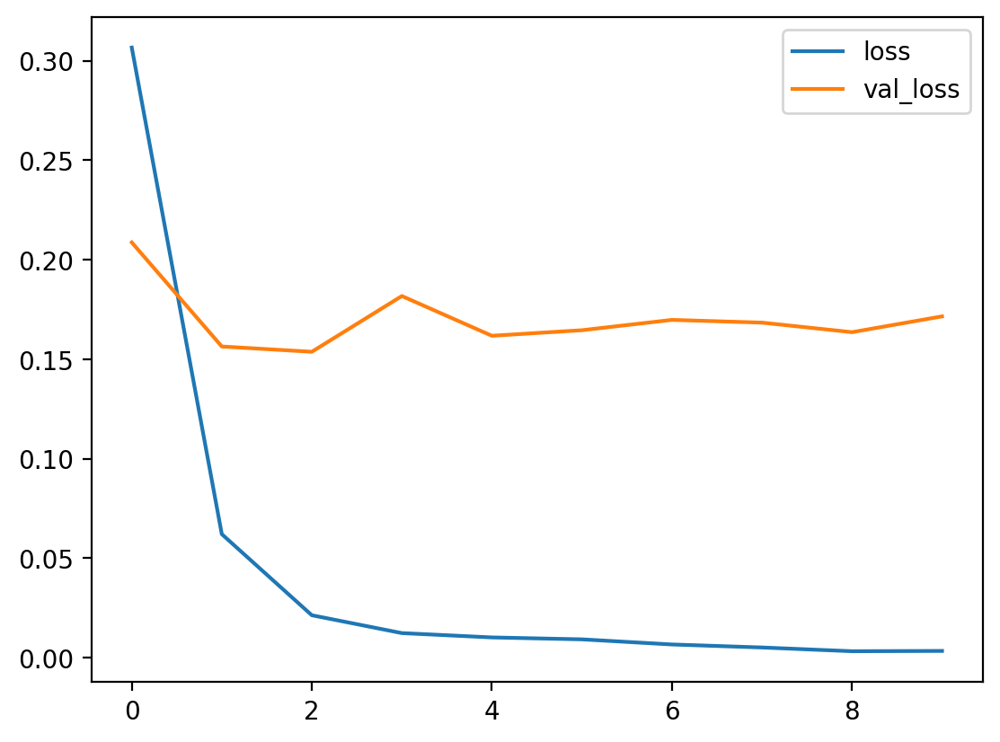

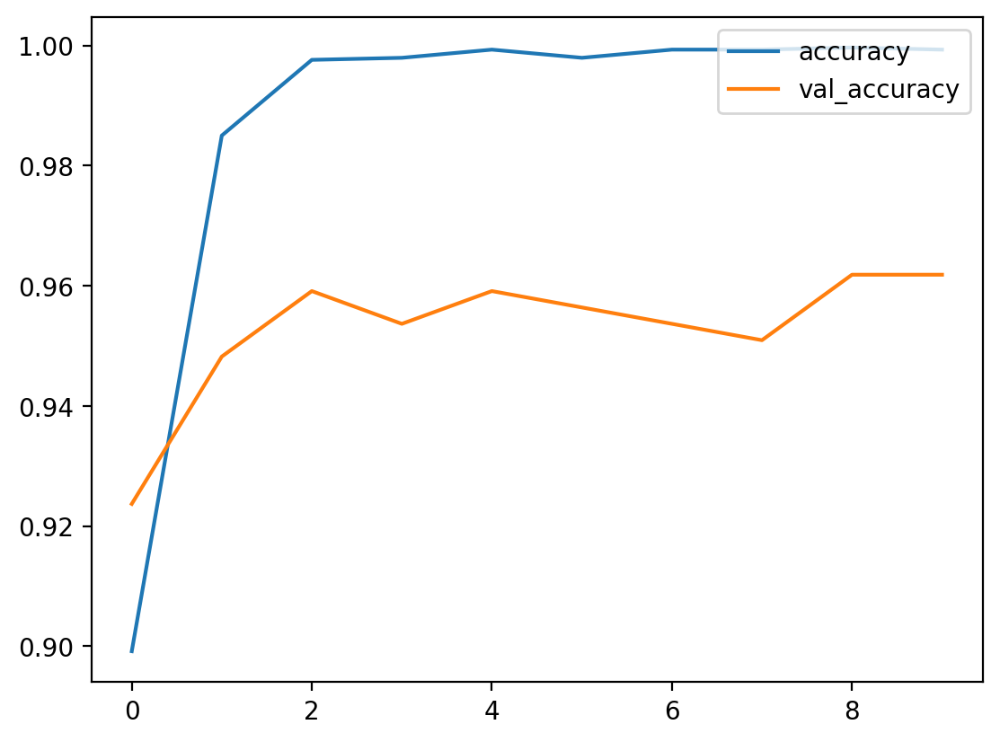

In [63]:
model.evaluate(valid_set)
plt.figure()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['loss','val_loss'],loc='upper right')
plt.show()
plt.figure()
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.legend(['accuracy','val_accuracy'],loc='upper right')
plt.show()

In [64]:
test_loss, test_acc = model.evaluate(test_set)

print('Test accuracy:', test_acc)
print('Test loss:', test_loss)

12/12 [==============================] - 1s 41ms/step - loss: 0.1341 - accuracy: 0.9455
Test accuracy: 0.9455040693283081
Test loss: 0.1340937465429306


In [81]:
import numpy as np

for image_batch, label_batch in test_set.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    pass

predictions = np.argmax(predictions, axis = 1)
predictions

1/1 [==============================] - 0s 33ms/step


array([2, 0, 0, 2, 0, 0, 2, 1, 3, 0, 0, 0, 3, 4, 0, 3, 2, 0, 2, 4, 2, 0,
       4, 0, 1, 4, 1, 4, 4, 3, 0, 4])

1/1 [==============================] - 0s 32ms/step


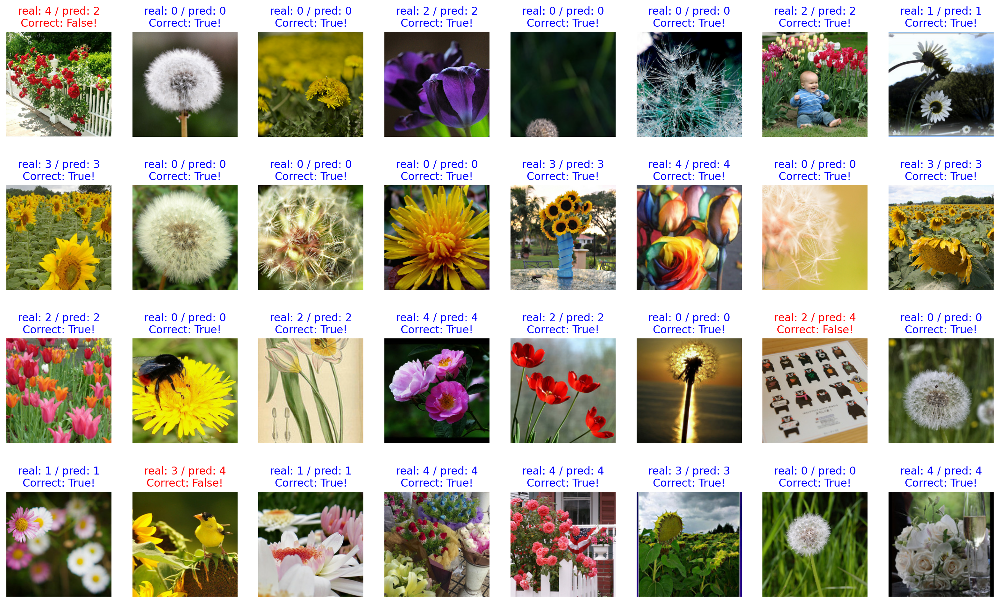

In [82]:
# 이미지 출력 및 예측 결과 확인
for image_batch, label_batch in test_set.take(1):
    predictions = model.predict(image_batch)

predictions = np.argmax(predictions, axis=1)

plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(image_batch, label_batch, predictions)):
    plt.subplot(4, 8, idx + 1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred: {prediction}\nCorrect: {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

plt.show()


In [83]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 32 * 100)

90.625


## 모델 활용

In [94]:
# # 모델 저장
# model.save('my_model.h5')

# loaded_model = tf.keras.models.load_model('my_model.h5')

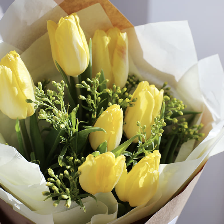

In [95]:
# import os
# from tensorflow.keras.preprocessing.image import load_img, img_to_array

IMG_SIZE = 224
img_dir_path = "/content/"
daisy_image_path = os.path.join(img_dir_path, 'tulips.jpg')

daisy_image = load_img(daisy_image_path, target_size = (IMG_SIZE, IMG_SIZE))
daisy_image

1/1 [==============================] - 1s 710ms/step


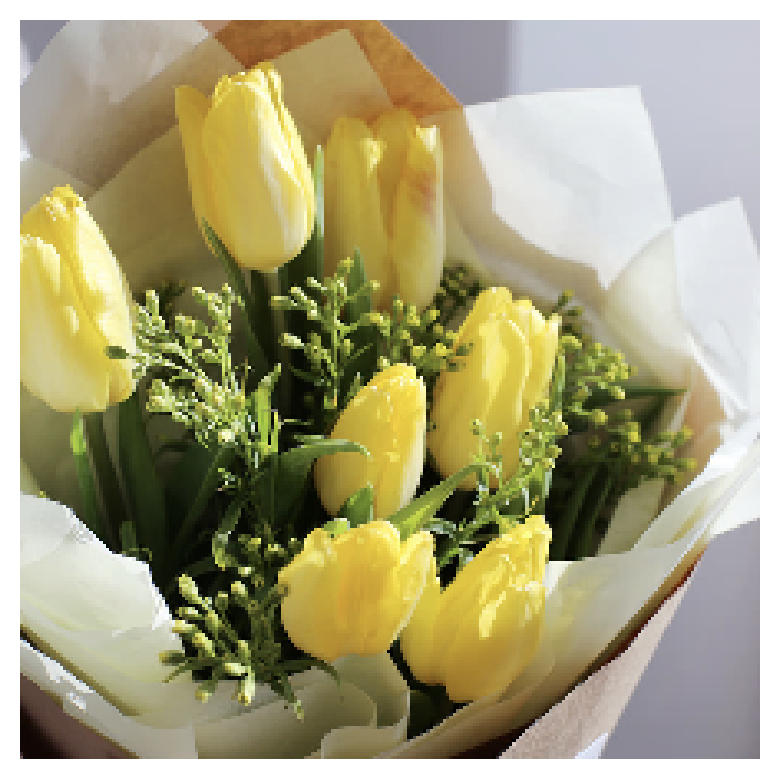

This image seems: tulip with 100.00% confidence.

All the metrics exceeded 90%, 
but all I got back was a feeling of helplessness. 
This project, which is neither a failure nor a success, 
must be finished now. What did I do?

1/1 [==============================] - 0s 22ms/step


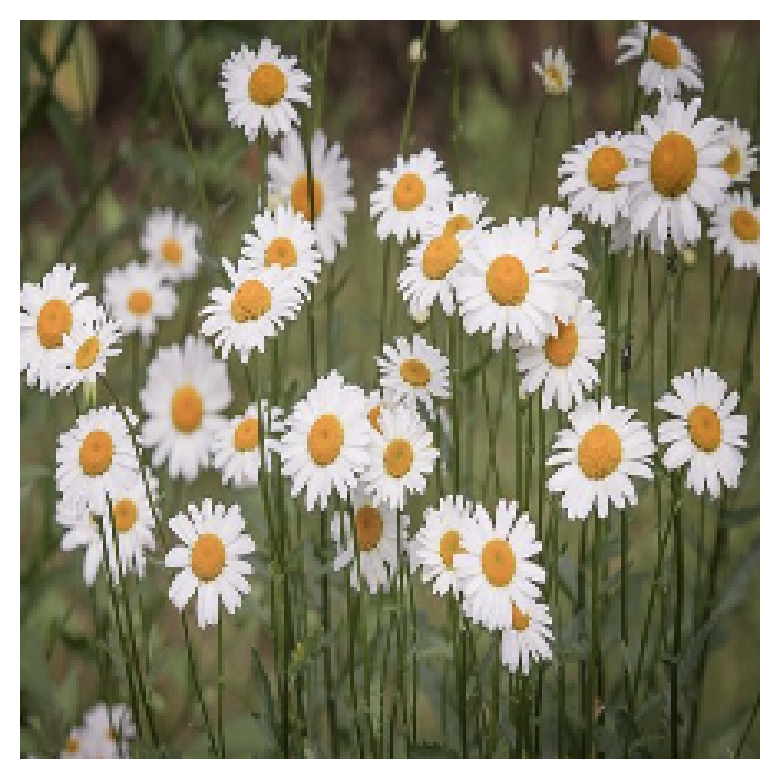

This image seems: tulip with 100.00% confidence.

All the metrics exceeded 90%, 
but all I got back was a feeling of helplessness. 
This project, which is neither a failure nor a success, 
must be finished now. What did I do?

1/1 [==============================] - 0s 22ms/step


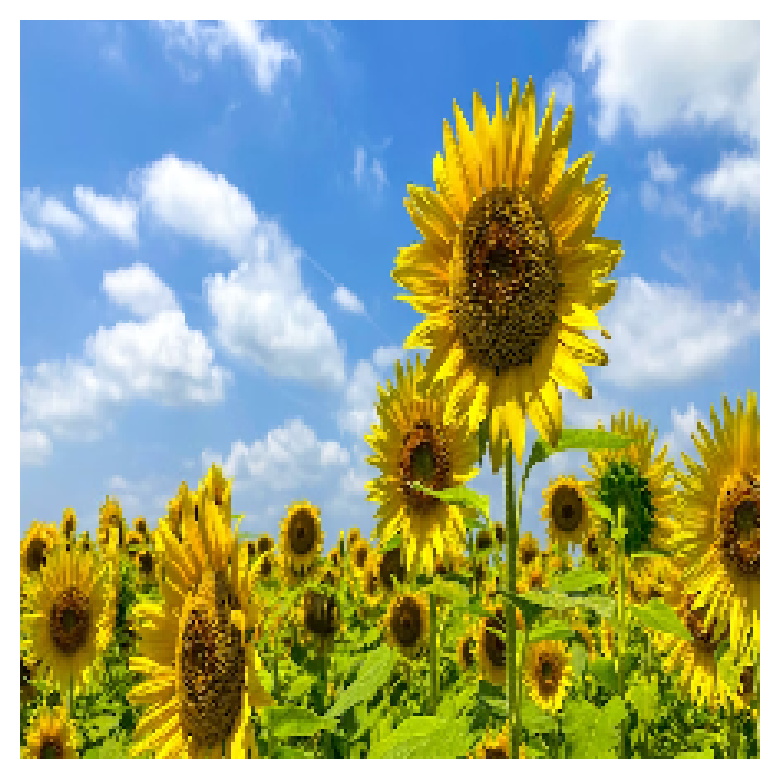

This image seems: tulip with 100.00% confidence.

All the metrics exceeded 90%, 
but all I got back was a feeling of helplessness. 
This project, which is neither a failure nor a success, 
must be finished now. What did I do?



In [122]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.xception import preprocess_input, decode_predictions
import numpy as np
import os
import matplotlib.pyplot as plt

# 모델 파일 경로 설정 (업로드한 모델 파일명으로 변경)
# model_path = '/content/my_model.h5'
# loaded_model = tf.keras.models.load_model(model_path)

# Reshape 함수 정의
def reshape_image(image_path, img_size=299):
    img = image.load_img(image_path, target_size=(img_size, img_size))
    img_array = image.img_to_array(img).reshape(1, img_size, img_size, 3)
    return img_array

def predict_and_display_image(image_path, model, class_labels, img_size=224):
    # 이미지 Reshape
    img_size_local = img_size  # 지역 변수로 설정
    reshaped_image = reshape_image(image_path, img_size_local)

    # 예측
    predictions = model.predict(reshaped_image)

    # 이미지 출력
    plt.imshow(image.load_img(image_path, target_size=(img_size_local, img_size_local)))
    plt.axis('off')
    plt.show()

    # 예측 결과 해석
    predicted_label_idx = np.argmax(predictions)
    predicted_label = class_labels[predicted_label_idx]
    confidence = np.max(predictions) * 100

    # 결과 출력
    print(f"This image seems: {predicted_label} with {confidence:.2f}% confidence.", end='\n\n')
    print("All the metrics exceeded 90%, \nbut all I got back was a feeling of helplessness. \nThis project, which is neither a failure nor a success, \nmust be finished now. What did I do?", end='\n\n')

# 테스트할 이미지 파일 경로 설정
image_paths = [
    '/content/tulips.jpg',
    '/content/daisy.jpg',
    '/content/sunflower.jpg',
]

# 함수 호출 반복
for image_path in image_paths:
    predict_and_display_image(image_path, loaded_model, ['daisy', 'rose', 'tulip', 'sunflower', 'dandelion']) # 아직 이 코드는 완성되지 못한 듯 합니다...


In [97]:
# # 모델 저장
# model.save('my_model.h5')

# # 저장된 모델 불러오기
# loaded_model = tf.keras.models.load_model('my_model.h5')

# # 새로운 데이터에 모델 적용
# predictions = loaded_model.predict(new_data)